# **Yolov5**

**Install Requirements**

In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14162, done.
remote: Counting objects: 100% (32/32), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 14162 (delta 15), reused 26 (delta 13), pack-reused 14130
Receiving objects: 100% (14162/14162), 13.54 MiB | 35.84 MiB/s, done.
Resolving deltas: 100% (9725/9725), done.
/content/yolov5
     |████████████████████████████████| 182 kB 4.6 MB/s 
     |████████████████████████████████| 62 kB 1.1 MB/s 
     |████████████████████████████████| 1.6 MB 58.5 MB/s 
     |████████████████████████████████| 41 kB 572 kB/s 
     |████████████████████████████████| 138 kB 8.3 MB/s 
     |████████████████████████████████| 54 kB 3.9 MB/s 
     |████████████████████████████████| 178 kB 57.6 MB/s 
     |████████████████████████████████| 145 kB 84.7 MB/s 
     |████████████████████████████████| 67 kB 7.2 MB/s 
     |████████████████████████████████| 62 kB 1.9 MB/s 
Setup complete. Using torch 1.12.1+cu113 (A100-SXM4-40GB)


**Load data**

Note: The yolov5 model will be eventually trained on WiderFace + Roboflow custom dataset. However, for demo on this notebook specifically, I just use a roboflow custom for convenience. 

In [ ]:
from roboflow import Roboflow

rf = Roboflow(api_key="X2KC2ZbWhi4re5YhDzCd")
project = rf.workspace("data-trgdm").project("finish_final_allready_gameover_finally_fin_win_stop_end")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Finish_Final_Allready_Gameover_Finally_Fin_Win_Stop_End-1 in yolov5pytorch:: 100%|██████████| 12258/12258 [00:01<00:00, 8067.03it/s]


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

**Train  YOLOv5 model**


In [ ]:
!python train.py --img 416 --batch 64 --epochs 20 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Finish_Final_Allready_Gameover_Finally_Fin_Win_Stop_End-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=20, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (A100-SXM4-40GB, 40536MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0,

**Evaluation**


In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1125), started 0:14:55 ago. (Use '!kill 1125' to kill it.)

<IPython.core.display.Javascript object>

**Inference**

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/Finish_Final_Allready_Gameover_Finally_Fin_Win_Stop_End-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (A100-SXM4-40GB, 40536MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/353 /content/yolov5/Finish_Final_Allready_Gameover_Finally_Fin_Win_Stop_End-1/test/images/2428098_jpg.rf.d42e874370b803dacf33785ceea66a41.jpg: 416x416 1 face, 9.3ms
image 2/353 /content/yolov5/Finish_Final_Allready_Gameover_Finally_Fin_Win_Stop_End-1/test/images/5337_j

**Face detection demo**

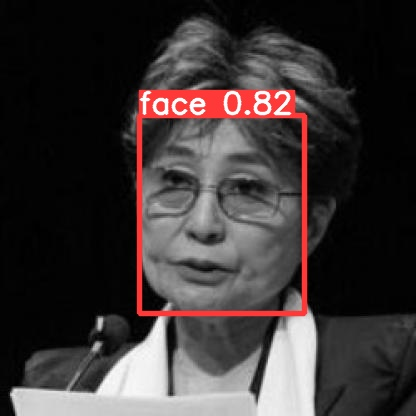

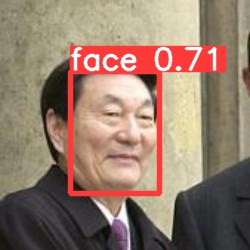

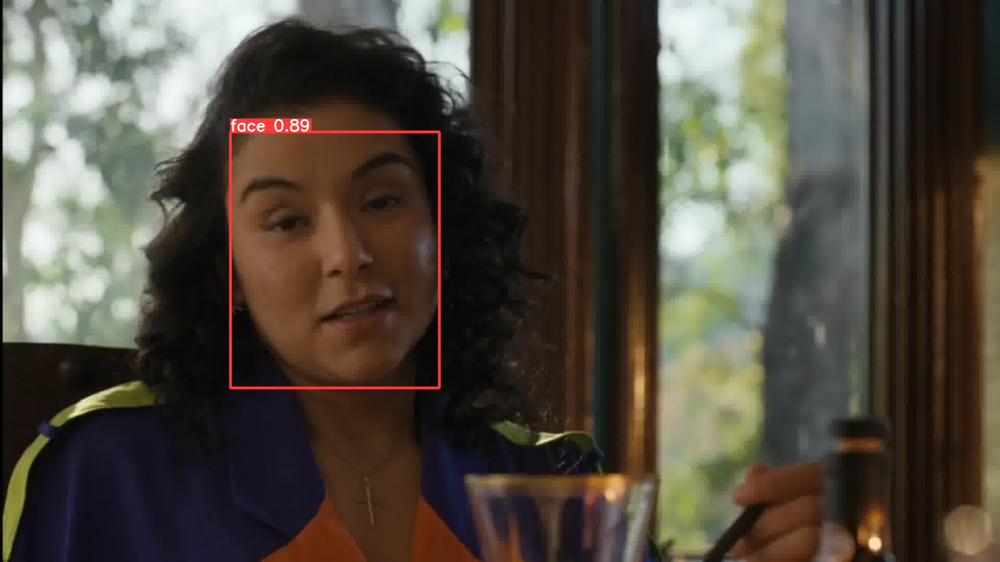

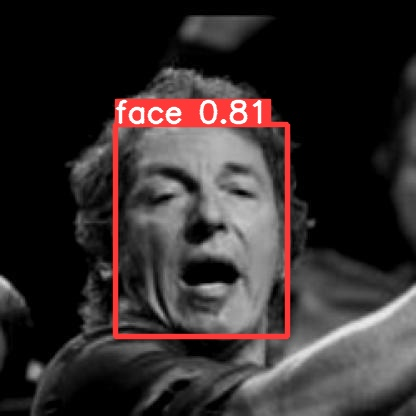

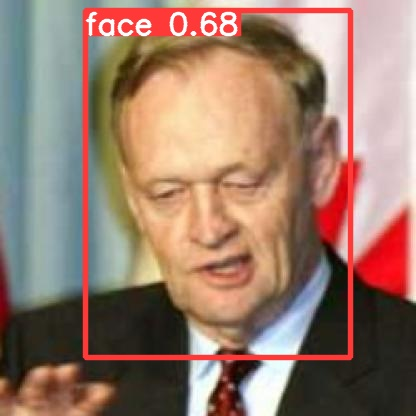

...

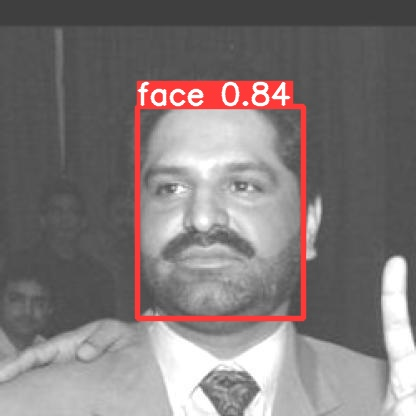

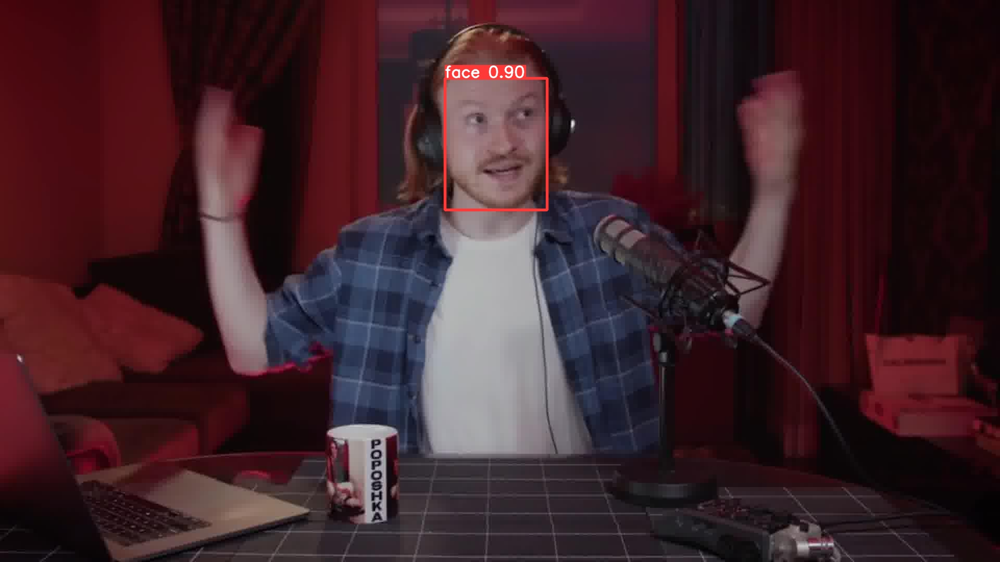

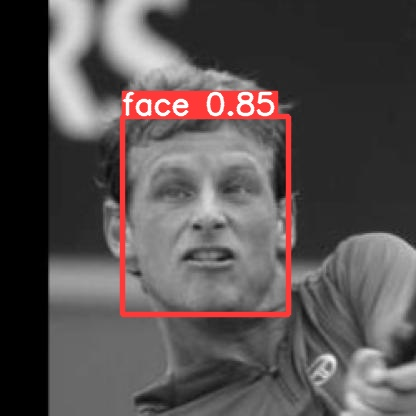

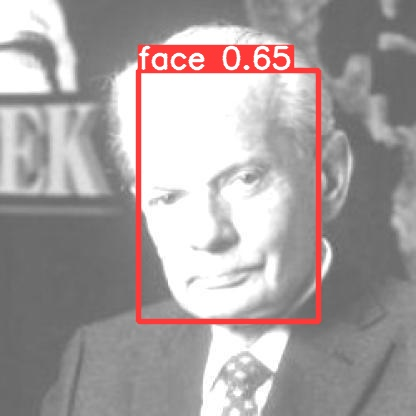

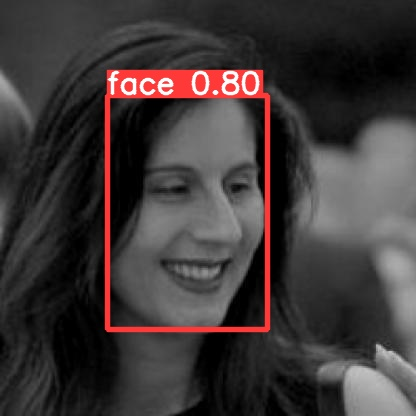

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Emotion classification


In [ ]:
!pip install --quiet pytorch-lightning

     |████████████████████████████████| 798 kB 4.6 MB/s 
     |████████████████████████████████| 512 kB 70.2 MB/s 
     |████████████████████████████████| 125 kB 75.9 MB/s 
     |████████████████████████████████| 87 kB 5.8 MB/s 


In [ ]:
import pandas as pd
import seaborn as sn
import torch
import numpy as np
import os

from IPython.core.display import display
from pytorch_lightning import LightningModule, Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar
from pytorch_lightning.loggers import CSVLogger
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader, random_split
from torchmetrics import Accuracy
import torchvision
from torchvision import transforms
from torchvision.datasets import MNIST
import matplotlib.pyplot as plt
from torchsummary import summary
import pytorch_lightning as pl
from IPython import display
pl.seed_everything(7)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


import warnings
warnings.filterwarnings("ignore")

INFO:lightning_lite.utilities.seed:Global seed set to 7


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/UzmaML/fer2013.csv")
df.head()

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training


In [ ]:
emotions = { #list of available emotions in the dataset
    0:"Angry",
    1:"Disgust",
    2:"Fear",
    3:"Happy",
    4:"Sad",
    5:"Surprize",
    6:"Neutral"
}

**Exploratory data analysis**

In [ ]:
count_emotions = (df.groupby(df['emotion'])['pixels'].count()).to_frame()
count_emotions['emotion name'] = [emotions[k] for k in emotions.keys()]
count_emotions

,pixels,emotion name
emotion,,
0,4953,Angry
1,547,Disgust
2,5121,Fear
3,8989,Happy
4,6077,Sad
5,4002,Surprize
6,6198,Neutral


In [ ]:
count_usage = (df.groupby(df['Usage'])['pixels'].count()).to_frame()
count_usage

,pixels
Usage,
PrivateTest,3589
PublicTest,3589
Training,28709


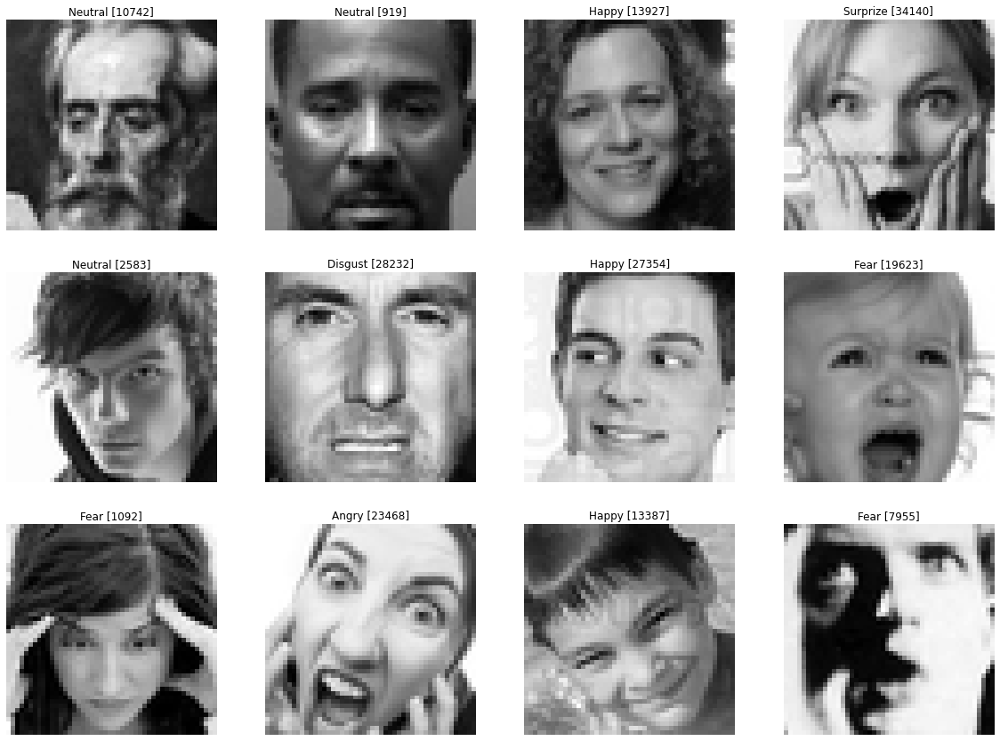

In [ ]:
# from PIL import Image
# pixels = df['pixels'][0]
# b = bytes(int(p) for p in pixels.split())
# i = Image.frombuffer('L',(48,48),b)
# di.save('a.png')
def visualize_images(n_img=4):
    indices = np.random.randint(0,df.shape[0],size=n_img)
#     print(indices)
    plt.figure(figsize=(20,20))
    for i,l in zip(indices,range(0,len(indices))):
        image_ar = np.array([i for i in  df['pixels'][i].split()] , dtype='float')
        pixels = np.reshape(image_ar,(48,48))
        ax = plt.subplot(4,4,l+1)
        plt.imshow(pixels,cmap='gray')
        plt.title(emotions[df['emotion'][i]]+" ["+str(i)+"]")
        plt.xticks()
        plt.yticks([])
        plt.axis("off")
visualize_images(12)

In [ ]:
X_train,y_train = [],[]
X_val,y_val = [],[]
X_test,y_test = [],[]
for index,row in df.iterrows():
    k = row['pixels'].split(" ")
    if row['Usage'] == 'Training':
        X_train.append(np.array(k))
        y_train.append(row['emotion'])
    elif row['Usage'] == 'PrivateTest':
        X_test.append(np.array(k))
        y_test.append(row['emotion'])
    elif row['Usage'] == 'PublicTest':
        X_val.append(np.array(k))
        y_val.append(row['emotion'])

X_train = np.array(X_train,dtype='float')
y_train = np.array(y_train)
X_test = np.array(X_test,dtype='float')
y_test = np.array(y_test)
X_val = np.array(X_val,dtype='float')
y_val = np.array(y_val)


X_train = X_train.reshape(X_train.shape[0],1,48,48)
X_test = X_test.reshape(X_test.shape[0],1,48,48)
X_val = X_val.reshape(X_val.shape[0],1,48,48)

X_train.shape,y_train.shape,X_test.shape,y_test.shape,X_val.shape,y_val.shape

((28709, 1, 48, 48),
 (28709,),
 (3589, 1, 48, 48),
 (3589,),
 (3589, 1, 48, 48),
 (3589,))

**define model**

In [ ]:
class createDataset(torch.utils.data.Dataset):

  def __init__(self, img, label, transform = None):

    self.img = img
    self.label = label
    self.transform = transform
  
  def __len__(self):
    return len(self.img)
  
  def __getitem__(self, idx):
    
    ret_img = torch.from_numpy(self.img[idx]).float()
    ret_label = self.label[idx]

    if self.transform:
      ret_img = self.transform(ret_img)
    
    return ret_img, ret_label

In [ ]:
class Net(pl.LightningModule):
    def __init__(self, net, lr):
        super().__init__()
        self.net = net
        self.lr = lr

        self.train_accuracy = Accuracy(task="multiclass", num_classes=7)
        self.val_accuracy = Accuracy(task="multiclass", num_classes=7)
        self.test_accuracy = Accuracy(task="multiclass", num_classes=7)

    def configure_optimizers(self):
        optimizer = torch.optim.SGD(self.net.parameters(), lr=self.lr, momentum=0.9, weight_decay = 0.0001)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer, mode='max', factor=0.5,patience=5, min_lr=0.00001, verbose=True)
        
        return {
       'optimizer': optimizer,
       'scheduler': scheduler,
       'monitor': 'val_loss'
   }

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self.net(x)
        loss = F.cross_entropy(y_hat, y)
        preds = torch.argmax(y_hat, dim=1)
        self.train_accuracy.update(preds, y)
 
        self.log("train_loss", loss, prog_bar=True)
        self.log("train_acc", self.train_accuracy,prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self.net(x)
        val_loss = F.cross_entropy(y_hat, y)
        preds = torch.argmax(y_hat, dim=1)
        self.val_accuracy.update(preds, y)
        
        self.log("val_loss", val_loss, prog_bar=True)
        self.log("val_acc", self.val_accuracy, prog_bar=True)
        

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self.net(x)
        test_loss = F.cross_entropy(y_hat, y)
        preds = torch.argmax(y_hat, dim=1)
        self.test_accuracy.update(preds, y)

        self.log("test_loss", test_loss, prog_bar=True)
        self.log("test_acc", self.test_accuracy, prog_bar=True)


In [ ]:

batch = 256
mu, st = 0.5, 0.5

train_transform = transforms.Compose([
            transforms.RandomResizedCrop(48, scale=(0.8, 1.2)),
            transforms.RandomApply(
                [transforms.RandomAffine(0, translate=(0.2, 0.2))], p=0.5),
            transforms.RandomHorizontalFlip(),
            transforms.RandomApply([transforms.RandomRotation(10)], p=0.5),

            transforms.Normalize(mean = mu, std = st)
        ])

test_transform = transforms.Compose([
            transforms.Normalize(mean = mu, std = st)
        ])



trainset = createDataset(X_train, y_train, transform = train_transform)

trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch,
                                          shuffle=True)

validationset = createDataset(X_val, y_val, transform = test_transform)

valloader = torch.utils.data.DataLoader(validationset, batch_size=batch,
                                         shuffle=False)

testset = createDataset(X_test, y_test, transform = test_transform)

testloader = torch.utils.data.DataLoader(testset, batch_size=batch,
                                         shuffle=False)

Augmented images

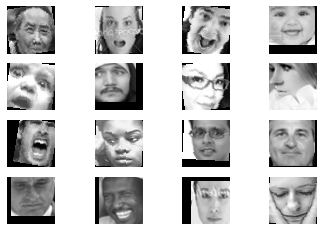

In [ ]:

def imshow(img):

    fig, ax = plt.subplots(4,4)
    ax = ax.flatten()
    for i in range(16):
      
      a = img[i]
      ax[i].imshow(a.reshape(48,48), cmap='gray')
      ax[i].axis("off")


# get some random training images
dataiter = iter(trainloader)

images, labels = dataiter.next()

imshow(images)

Resnet50 pretrained on vggface

model link: https://github.com/cydonia999/VGGFace2-pytorch

In [ ]:
import pickle
with open('/content/drive/MyDrive/UzmaML/resnet50_scratch_weight.pkl', 'rb') as f:
  obj = f.read()
  weights = {key: torch.from_numpy(arr) for key, arr in pickle.loads(obj, encoding='latin1').items()}


we changed the conv1 layer, fc layer and delete maxpool layer. 

In [ ]:
resnet50 = torchvision.models.resnet50(pretrained = False)
resnet50.fc = nn.Linear(in_features=2048, out_features=8631, bias=True)
resnet50.load_state_dict(weights)

resnet50.conv1 = nn.Conv2d(1, 64, kernel_size = 3, padding=1, bias=False)
resnet50.maxpool = nn.Sequential()
resnet50.fc = nn.Sequential(
    nn.Dropout(p=.5),
    nn.Linear(in_features=2048, out_features=1024, bias=True),
    nn.Dropout(p=.5),
    nn.Linear(in_features=1024, out_features=7, bias=True)
)
resnet50.to(device)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): Sequential()
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momen

In [ ]:
from torchsummary import torchsummary
summary(resnet50,(1, 48, 48))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 48, 48]             576
       BatchNorm2d-2           [-1, 64, 48, 48]             128
              ReLU-3           [-1, 64, 48, 48]               0
            Conv2d-4           [-1, 64, 48, 48]           4,096
       BatchNorm2d-5           [-1, 64, 48, 48]             128
              ReLU-6           [-1, 64, 48, 48]               0
            Conv2d-7           [-1, 64, 48, 48]          36,864
       BatchNorm2d-8           [-1, 64, 48, 48]             128
              ReLU-9           [-1, 64, 48, 48]               0
           Conv2d-10          [-1, 256, 48, 48]          16,384
      BatchNorm2d-11          [-1, 256, 48, 48]             512
           Conv2d-12          [-1, 256, 48, 48]          16,384
      BatchNorm2d-13          [-1, 256, 48, 48]             512
             ReLU-14          [-1, 256,

**Train our model**

In [ ]:
model = Net(resnet50, lr = 0.0005)
trainer = pl.Trainer(
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,
    max_epochs=100,
    logger=CSVLogger(save_dir="emotionresnet50/"),
)

trainer.fit(model, trainloader, valloader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name           | Type               | Params
------------------------------------------------------
0 | net            | ResNet             | 25.6 M
1 | train_accuracy | MulticlassAccuracy | 0     
2 | val_accuracy   | MulticlassAccuracy | 0     
3 | test_accuracy  | MulticlassAccuracy | 0     
------------------------------------------------------
25.6 M    Trainable params
0         Non-trainable params
25.6 M    Total params
102.418   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

**Result analysis**

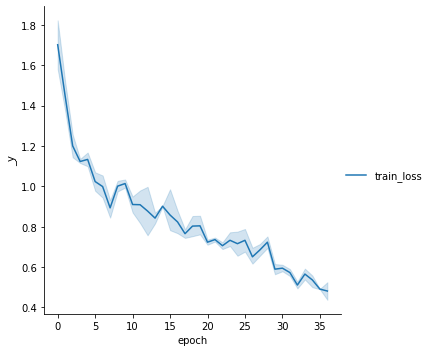

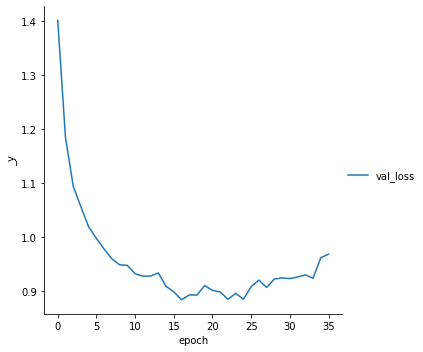

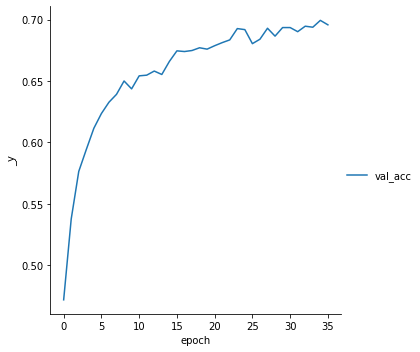

In [ ]:
metrics = pd.read_csv(f"{trainer.logger.log_dir}/metrics.csv")
del metrics["step"]
metrics.set_index("epoch", inplace=True)
#display(metrics.dropna(axis=1, how="all").head())
sn.relplot(data=metrics[["train_loss"]], kind="line")
sn.relplot(data=metrics[["val_loss"]], kind="line")
sn.relplot(data=metrics[["val_acc"]], kind="line")


In [ ]:
trainer.test(model, testloader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test_acc            0.7043744921684265
        test_loss           0.8975275158882141
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_loss': 0.8975275158882141, 'test_acc': 0.7043744921684265}]